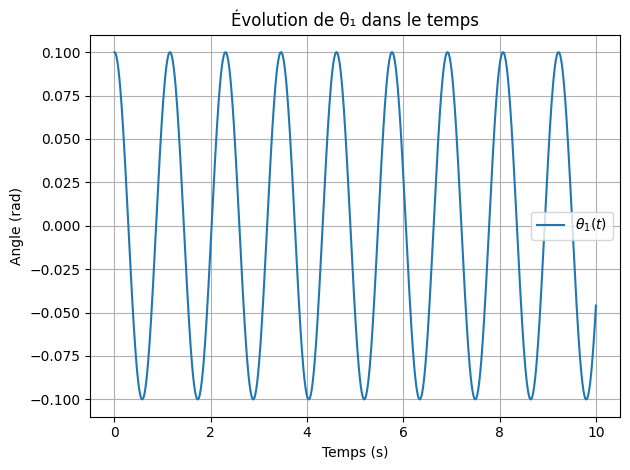

In [54]:
from sympy import symbols, cos, lambdify
from sympy.physics.mechanics import dynamicsymbols, LagrangesMethod
from scipy.integrate import solve_ivp
import numpy as np
import matplotlib.pyplot as plt

# --- Étape 1 : définition symbolique du système ---
# Constantes
m1, l1, r1, k1 = symbols('m1 l1 r1 k1')
t = symbols('t')

# Coordonnée généralisée
theta1 = dynamicsymbols('theta1')
theta1_dot = theta1.diff(t)

# Énergie cinétique : rotation autour d’un axe
Ec = (1/6) * m1 * (l1**2 + r1**2) * theta1_dot**2

# Énergie potentielle : ressort rappelant vers θ=0
Ep = (1/2) * k1 * theta1**2

# Lagrangien
L = Ec - Ep

# --- Étape 2 : Équation de Lagrange ---
LM = LagrangesMethod(L, [theta1])
LM.form_lagranges_equations()
rhs = LM.rhs()  # [theta1_dot, theta1_ddot]

# --- Étape 3 : Conversion en fonction Python ---
params = (m1, l1, r1, k1)
states = (theta1, theta1_dot)
rhs_func = lambdify(params + states, rhs, modules='numpy')

# Valeurs numériques
param_values = {
    m1: 1.0,
    l1: 1.0,
    r1: 0.1,
    k1: 10.0
}

# Système pour solve_ivp
def system(t, y):
    θ1, θ1_dot = y
    args = tuple(param_values[p] for p in params) + (θ1, θ1_dot)
    out = rhs_func(*args)
    return [out[0].item(), out[1].item()]

# Conditions initiales
y0 = [0.1, 0]  # [θ1, θ1_dot]

# --- Étape 4 : Simulation ---
t_span = (0, 10)
t_eval = np.linspace(*t_span, 1000)
sol = solve_ivp(system, t_span, y0, t_eval=t_eval, method='RK45', rtol=1e-9, atol=1e-9)

# --- Étape 5 : Affichage ---
plt.plot(sol.t, sol.y[0], label=r'$\theta_1(t)$')
plt.xlabel("Temps (s)")
plt.ylabel("Angle (rad)")
plt.title("Évolution de θ₁ dans le temps")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


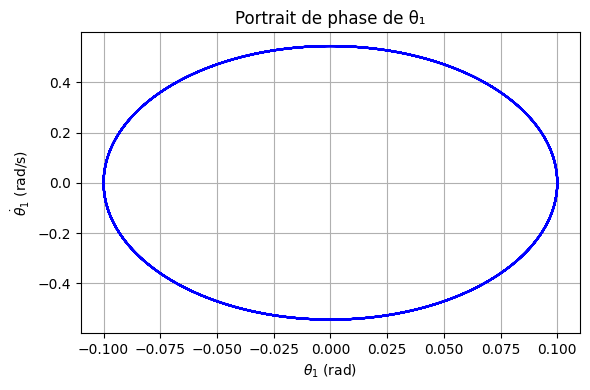

In [55]:
# --- Portrait de phase pour θ₁ ---
plt.figure(figsize=(6, 4))
plt.plot(sol.y[0], sol.y[1], color='blue')  # θ₁ vs θ̇₁
plt.xlabel(r'$\theta_1$ (rad)')
plt.ylabel(r'$\dot{\theta}_1$ (rad/s)')
plt.title('Portrait de phase de θ₁')
plt.grid(True)
plt.tight_layout()
plt.show()

In [56]:
from sympy import symbols, cos
from sympy.physics.mechanics import dynamicsymbols, LagrangesMethod

# Définition des variables symboliques
m1, m2, l1, l2, r1, r2, k1, k2 = symbols('m1 m2 l1 l2 r1 r2 k1 k2')
t = symbols('t')

# Coordonnées généralisées
theta1, theta2 = dynamicsymbols('theta1 theta2')
theta1_dot = theta1.diff(t)
theta2_dot = theta2.diff(t)

# Énergie cinétique (reprend exactement tes coefficients)
Ec = (1/6) * m1 * (l1**2 + r1**2) * theta1_dot**2 \
   + (1/2) * m2 * l1**2 * theta1_dot**2 \
   + (7/24) * m2 * l2**2 * theta2_dot**2 \
   - (1/2) * m2 * l1 * l2 * theta1_dot * theta2_dot * cos(theta2 - theta1) \
   + (1/6) * m2 * r2**2 * theta2_dot**2

# Énergie potentielle
Ep = (1/2) * k1 * theta1**2 + (1/2) * k2 * (theta2 - theta1)**2

# Lagrangien
L = Ec - Ep

# LagrangesMethod pour générer les équations du mouvement
coords = [theta1, theta2]
LM = LagrangesMethod(L, coords)
eom = LM.form_lagranges_equations()

# Affichage
eom


Matrix([
[1.0*k1*theta1(t) + 0.5*k2*(2*theta1(t) - 2*theta2(t)) + 1.0*l1**2*m2*Derivative(theta1(t), (t, 2)) + 0.5*l1*l2*m2*(Derivative(theta1(t), t) - Derivative(theta2(t), t))*sin(theta1(t) - theta2(t))*Derivative(theta2(t), t) - 0.5*l1*l2*m2*sin(theta1(t) - theta2(t))*Derivative(theta1(t), t)*Derivative(theta2(t), t) - 0.5*l1*l2*m2*cos(theta1(t) - theta2(t))*Derivative(theta2(t), (t, 2)) + 0.333333333333333*m1*(l1**2 + r1**2)*Derivative(theta1(t), (t, 2))],
[              0.5*k2*(-2*theta1(t) + 2*theta2(t)) + 0.5*l1*l2*m2*(Derivative(theta1(t), t) - Derivative(theta2(t), t))*sin(theta1(t) - theta2(t))*Derivative(theta1(t), t) + 0.5*l1*l2*m2*sin(theta1(t) - theta2(t))*Derivative(theta1(t), t)*Derivative(theta2(t), t) - 0.5*l1*l2*m2*cos(theta1(t) - theta2(t))*Derivative(theta1(t), (t, 2)) + 0.583333333333333*l2**2*m2*Derivative(theta2(t), (t, 2)) + 0.333333333333333*m2*r2**2*Derivative(theta2(t), (t, 2))]])

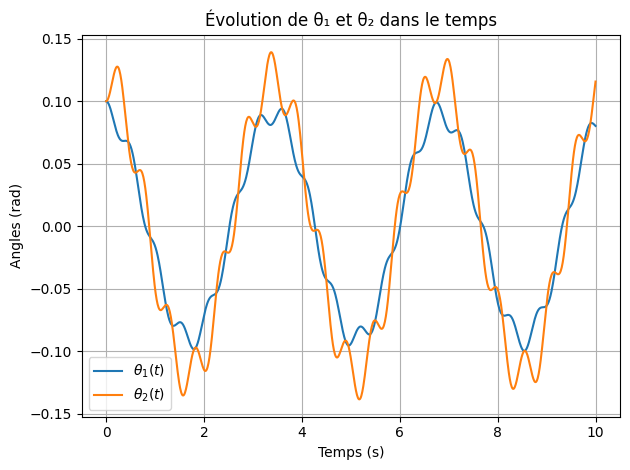

In [57]:
from sympy import symbols, cos, lambdify
from sympy.physics.mechanics import dynamicsymbols, LagrangesMethod
from scipy.integrate import solve_ivp
import numpy as np
import matplotlib.pyplot as plt

# --- Étape 1 : définition symbolique du système ---
# Constantes
m1, m2, l1, l2, r1, r2, k1, k2 = symbols('m1 m2 l1 l2 r1 r2 k1 k2')
t = symbols('t')

# Coordonnées généralisées
theta1, theta2 = dynamicsymbols('theta1 theta2')
theta1_dot = theta1.diff(t)
theta2_dot = theta2.diff(t)

# Énergie cinétique
Ec = (1/6) * m1 * (l1**2 + r1**2) * theta1_dot**2 \
   + (1/2) * m2 * l1**2 * theta1_dot**2 \
   + (1/6) * m2 * (l2**2 + r2**2) * theta2_dot**2 \
   + (1/2) * m2 * l1 * l2 * theta1_dot * theta2_dot * cos(theta2 - theta1)

# Énergie potentielle
Ep = (1/2) * k1 * theta1**2 + (1/2) * k2 * (theta2 - theta1)**2

# Lagrangien
L = Ec - Ep

# --- Étape 2 : Génération des équations d’Euler-Lagrange ---
coords = [theta1, theta2]
LM = LagrangesMethod(L, coords)
LM.form_lagranges_equations()
rhs = LM.rhs()  # [theta1_dot, theta2_dot, theta1_ddot, theta2_ddot]

# --- Étape 3 : Conversion en fonction Python utilisable par solve_ivp ---
params = (m1, m2, l1, l2, r1, r2, k1, k2)
states = (theta1, theta2, theta1_dot, theta2_dot)
rhs_func = lambdify(params + states, rhs, modules='numpy')

# Valeurs numériques des constantes
param_values = {
    m1: 1.0, m2: 1.0,
    l1: 1.0, l2: 1.0,
    r1: 0.1, r2: 0.1,
    k1: 10.0, k2: 10.0
}

# Fonction du système pour solve_ivp
def system(t, y):
    θ1, θ2, θ1_dot, θ2_dot = y
    args = tuple(param_values[p] for p in params) + (θ1, θ2, θ1_dot, θ2_dot)
    out = rhs_func(*args)
    return [out[0].item(), out[1].item(), out[2].item(), out[3].item()]


# Conditions initiales
y0 = [0.1, 0.1, 0, 0]  # [θ1, θ2, θ1_dot, θ2_dot]

# --- Étape 4 : Simulation numérique ---
t_span = (0, 10)
t_eval = np.linspace(*t_span, 1000)
sol = solve_ivp(system, t_span, y0, t_eval=t_eval, method='RK45', rtol=1e-9, atol=1e-9)

# --- Étape 5 : Affichage ---
plt.plot(sol.t, sol.y[0], label=r'$\theta_1(t)$')
plt.plot(sol.t, sol.y[1], label=r'$\theta_2(t)$')
plt.xlabel("Temps (s)")
plt.ylabel("Angles (rad)")
plt.title("Évolution de θ₁ et θ₂ dans le temps")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


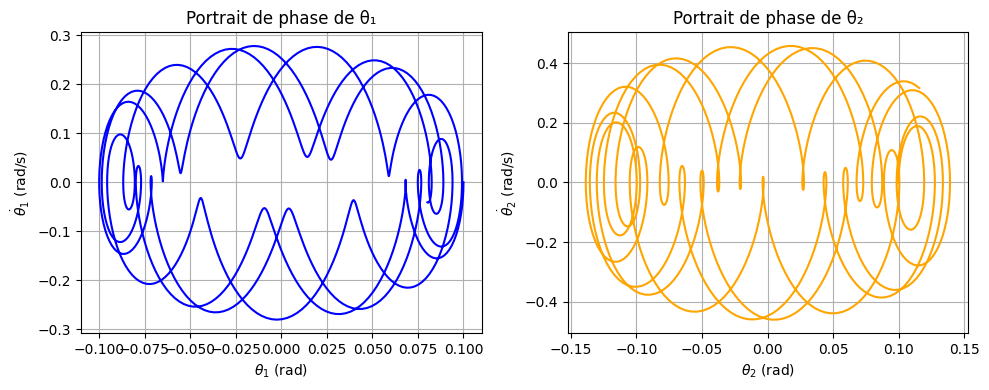

In [58]:
plt.figure(figsize=(10, 4))

# Portrait de phase pour la barre 1
plt.subplot(1, 2, 1)
plt.plot(sol.y[0], sol.y[2], color='blue')
plt.xlabel(r'$\theta_1$ (rad)')
plt.ylabel(r'$\dot{\theta}_1$ (rad/s)')
plt.title('Portrait de phase de θ₁')
plt.grid(True)

# Portrait de phase pour la barre 2
plt.subplot(1, 2, 2)
plt.plot(sol.y[1], sol.y[3], color='orange')
plt.xlabel(r'$\theta_2$ (rad)')
plt.ylabel(r'$\dot{\theta}_2$ (rad/s)')
plt.title('Portrait de phase de θ₂')
plt.grid(True)

plt.tight_layout()
plt.show()


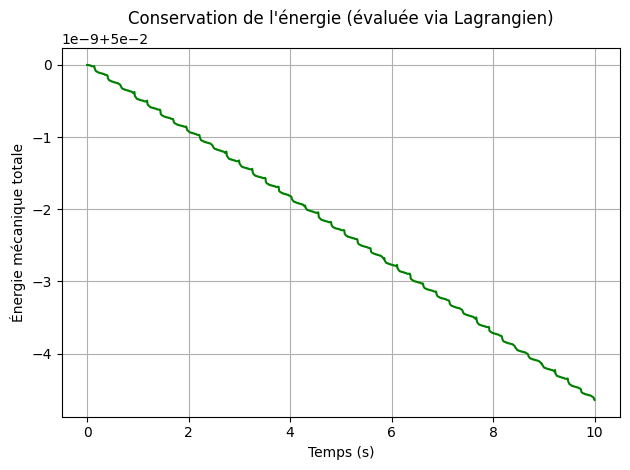

In [59]:
from sympy import lambdify

# Énergie totale symbolique
E_total_sym = Ec + Ep

# Conversion en fonction Python
E_total_func = lambdify(params + (theta1, theta2, theta1_dot, theta2_dot), E_total_sym, modules='numpy')

# Préparer les arguments pour l’évaluation
param_vals = tuple(param_values[p] for p in params)
theta1_vals = sol.y[0]
theta2_vals = sol.y[1]
theta1_dot_vals = sol.y[2]
theta2_dot_vals = sol.y[3]

# Calcul de l’énergie à chaque instant
E_vals = E_total_func(*param_vals, theta1_vals, theta2_vals, theta1_dot_vals, theta2_dot_vals)

# Tracé
plt.plot(sol.t, E_vals, color='green')
plt.xlabel("Temps (s)")
plt.ylabel("Énergie mécanique totale")
plt.title("Conservation de l'énergie (évaluée via Lagrangien)")
plt.grid(True)
plt.tight_layout()
plt.show()


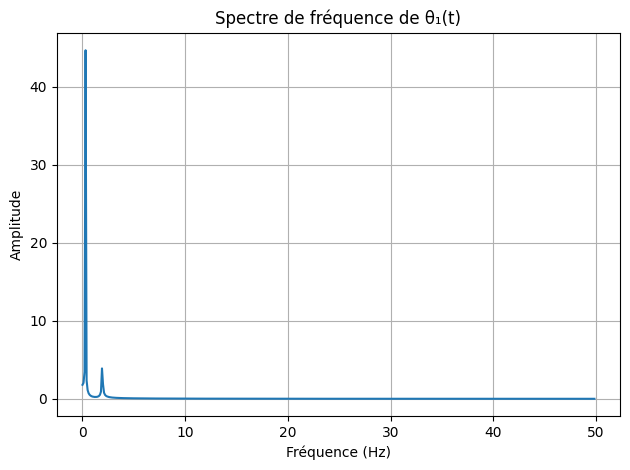

In [60]:
from scipy.fft import fft, fftfreq

# Appliquer la FFT
spectrum = np.abs(fft(sol.y[0]))  # θ₁(t)
freqs = fftfreq(len(sol.t), d=sol.t[1] - sol.t[0])

# Tracer le spectre
plt.plot(freqs[:len(freqs)//2], spectrum[:len(freqs)//2])
plt.xlabel("Fréquence (Hz)")
plt.ylabel("Amplitude")
plt.title("Spectre de fréquence de θ₁(t)")
plt.grid(True)
plt.tight_layout()
plt.show()


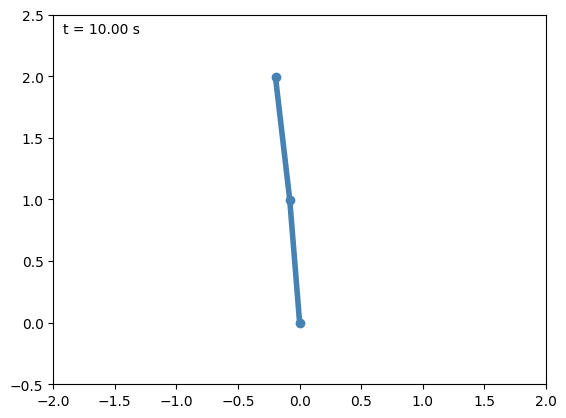

In [61]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# --- Calcul des positions des extrémités ---
theta1_vals = sol.y[0]
theta2_vals = sol.y[1]
t_vals = sol.t

l1_val = param_values[l1]
l2_val = param_values[l2]

xA, yA = 0, 0
xB = - l1_val * np.sin(theta1_vals)
yB = + l1_val * np.cos(theta1_vals)
xC = xB - l2_val * np.sin(theta2_vals)
yC = yB + l2_val * np.cos(theta2_vals)

# --- Création de la figure ---
fig, ax = plt.subplots()
ax.set_aspect('equal')
ax.set_xlim(-2, 2)
ax.set_ylim(-0.5, 2.5)
line, = ax.plot([], [], 'o-', lw=4, color='steelblue')
time_text = ax.text(0.02, 0.95, '', transform=ax.transAxes)

# --- Fonction d'initialisation ---
def init():
    line.set_data([], [])
    time_text.set_text('')
    return line, time_text

# --- Fonction d'update à chaque frame ---
def update(i):
    this_x = [xA, xB[i], xC[i]]
    this_y = [yA, yB[i], yC[i]]
    line.set_data(this_x, this_y)
    time_text.set_text(f"t = {t_vals[i]:.2f} s")
    return line, time_text

# --- Création de l'animation ---
ani = animation.FuncAnimation(fig, update, frames=len(t_vals),
                              init_func=init, blit=True, interval=20)

# --- Affichage dans JupyterLab ---
HTML(ani.to_jshtml())


In [62]:
from sympy import symbols, sin, cos, diff
from sympy.physics.mechanics import dynamicsymbols

def energie_cinetique_translation(N):
    t = symbols('t')

    # Symboles dynamiques
    theta = dynamicsymbols(f'theta1:{N+1}')        # theta1(t), ..., thetaN(t)
    theta_dot = [diff(th, t) for th in theta]

    # Paramètres physiques
    m = symbols(f'm1:{N+1}')                       # masses
    l = symbols(f'l1:{N+1}')                       # longueurs

    # Position des centres de masse selon la récurrence que tu as donnée
    x = []
    y = []

    for i in range(N):
        if i == 0:
            xi = -(l[i] / 2) * sin(theta[i])
            yi =  (l[i] / 2) * cos(theta[i])
        else:
            xi = x[i-1] - (l[i-1]/2) * sin(theta[i-1]) - (l[i]/2) * sin(theta[i])
            yi = y[i-1] + (l[i-1]/2) * cos(theta[i-1]) + (l[i]/2) * cos(theta[i])
        x.append(xi)
        y.append(yi)

    # Calcul des vitesses et de l'énergie cinétique de translation
    Ec_trans = 0
    for i in range(N):
        vx = diff(x[i], t)
        vy = diff(y[i], t)
        v2 = vx**2 + vy**2
        Ec_trans += (1/2) * m[i] * v2

    return Ec_trans


In [63]:
Ec_translation = energie_cinetique_translation(N=2)
Ec_translation


0.5*m1*(l1**2*sin(theta1(t))**2*Derivative(theta1(t), t)**2/4 + l1**2*cos(theta1(t))**2*Derivative(theta1(t), t)**2/4) + 0.5*m2*((-l1*sin(theta1(t))*Derivative(theta1(t), t) - l2*sin(theta2(t))*Derivative(theta2(t), t)/2)**2 + (-l1*cos(theta1(t))*Derivative(theta1(t), t) - l2*cos(theta2(t))*Derivative(theta2(t), t)/2)**2)

In [64]:
from sympy import symbols
from sympy.physics.mechanics import dynamicsymbols

def energie_cinetique_rotation(N):
    # Temps
    t = symbols('t')

    # Variables dynamiques : angles et dérivées
    theta = dynamicsymbols(f'theta1:{N+1}')
    theta_dot = [theta_i.diff(t) for theta_i in theta]

    # Paramètres physiques
    m = symbols(f'm1:{N+1}')       # masses
    l = symbols(f'l1:{N+1}')       # longueurs
    r = symbols(f'r1:{N+1}')       # demi-largeurs

    # Énergie cinétique de rotation
    Ec_rot = 0
    for i in range(N):
        I_i = m[i] * (l[i]**2 / 12 + r[i]**2 / 3)     # moment d'inertie en son centre
        Ec_rot += (1/2) * I_i * theta_dot[i]**2       # 1/2 I ω²

    return Ec_rot


In [65]:
Ec_rotation = energie_cinetique_rotation(N=2)
Ec_rotation


0.5*m1*(l1**2/12 + r1**2/3)*Derivative(theta1(t), t)**2 + 0.5*m2*(l2**2/12 + r2**2/3)*Derivative(theta2(t), t)**2

In [66]:
from sympy import symbols
from sympy.physics.mechanics import dynamicsymbols

def energie_potentielle_ressorts(N):
    # Temps
    t = symbols('t')

    # Angles généralisés dépendants du temps
    theta = dynamicsymbols(f'theta1:{N+1}')  # theta1(t), theta2(t), ..., thetaN(t)

    # Raideurs des ressorts
    k = symbols(f'k1:{N+1}')  # k1, k2, ..., kN

    # Énergie potentielle totale
    Ep = 0
    for i in range(N):
        theta_prev = 0 if i == 0 else theta[i - 1]
        Ep += (1/2) * k[i] * (theta[i] - theta_prev)**2

    return Ep


In [67]:
Ep_total = energie_potentielle_ressorts(N=2)
Ep_total


0.5*k1*theta1(t)**2 + 0.5*k2*(-theta1(t) + theta2(t))**2

In [68]:
from sympy import symbols, sin, cos, diff
from sympy.physics.mechanics import dynamicsymbols, LagrangesMethod

def solve_systeme_lagrangien(N):
    t = symbols('t')

    # Variables dynamiques : angles et dérivées
    theta = dynamicsymbols(f'theta1:{N+1}')
    theta_dot = [diff(th, t) for th in theta]

    # Paramètres physiques : masses, longueurs, demi-largeurs, raideurs
    m = symbols(f'm1:{N+1}')
    l = symbols(f'l1:{N+1}')
    r = symbols(f'r1:{N+1}')
    k = symbols(f'k1:{N+1}')

    # Position des centres de masse (par récurrence)
    x, y = [], []
    for i in range(N):
        if i == 0:
            xi = -(l[i] / 2) * sin(theta[i])
            yi =  (l[i] / 2) * cos(theta[i])
        else:
            xi = x[i-1] - (l[i-1]/2) * sin(theta[i-1]) - (l[i]/2) * sin(theta[i])
            yi = y[i-1] + (l[i-1]/2) * cos(theta[i-1]) + (l[i]/2) * cos(theta[i])
        x.append(xi)
        y.append(yi)

    # Énergie cinétique de translation
    Ec_trans = 0
    for i in range(N):
        vx = diff(x[i], t)
        vy = diff(y[i], t)
        v2 = vx**2 + vy**2
        Ec_trans += (1/2) * m[i] * v2

    # Énergie cinétique de rotation
    Ec_rot = 0
    for i in range(N):
        I_i = m[i] * (l[i]**2 / 12 + r[i]**2 / 3)
        Ec_rot += (1/2) * I_i * theta_dot[i]**2

    # Énergie potentielle (ressorts de torsion)
    Ep = 0
    for i in range(N):
        theta_prev = 0 if i == 0 else theta[i - 1]
        Ep += (1/2) * k[i] * (theta[i] - theta_prev)**2

    # Lagrangien
    L = Ec_trans + Ec_rot - Ep

    # Équations d'Euler-Lagrange
    LM = LagrangesMethod(L, theta)
    eom = LM.form_lagranges_equations()

    return L, eom


In [69]:
L, equations = solve_systeme_lagrangien(N=2)
display(L)
display(equations)


-0.5*k1*theta1(t)**2 - 0.5*k2*(-theta1(t) + theta2(t))**2 + 0.5*m1*(l1**2/12 + r1**2/3)*Derivative(theta1(t), t)**2 + 0.5*m1*(l1**2*sin(theta1(t))**2*Derivative(theta1(t), t)**2/4 + l1**2*cos(theta1(t))**2*Derivative(theta1(t), t)**2/4) + 0.5*m2*(l2**2/12 + r2**2/3)*Derivative(theta2(t), t)**2 + 0.5*m2*((-l1*sin(theta1(t))*Derivative(theta1(t), t) - l2*sin(theta2(t))*Derivative(theta2(t), t)/2)**2 + (-l1*cos(theta1(t))*Derivative(theta1(t), t) - l2*cos(theta2(t))*Derivative(theta2(t), t)/2)**2)

Matrix([
[1.0*k1*theta1(t) + 0.5*k2*(2*theta1(t) - 2*theta2(t)) + 1.0*m1*(l1**2/12 + r1**2/3)*Derivative(theta1(t), (t, 2)) + 0.5*m1*(l1**2*sin(theta1(t))**2*Derivative(theta1(t), (t, 2))/2 + l1**2*cos(theta1(t))**2*Derivative(theta1(t), (t, 2))/2) - 0.5*m2*(-2*l1*(-l1*sin(theta1(t))*Derivative(theta1(t), t) - l2*sin(theta2(t))*Derivative(theta2(t), t)/2)*cos(theta1(t))*Derivative(theta1(t), t) + 2*l1*(-l1*cos(theta1(t))*Derivative(theta1(t), t) - l2*cos(theta2(t))*Derivative(theta2(t), t)/2)*sin(theta1(t))*Derivative(theta1(t), t)) + 0.5*m2*(-2*l1*(-l1*sin(theta1(t))*Derivative(theta1(t), t) - l2*sin(theta2(t))*Derivative(theta2(t), t)/2)*cos(theta1(t))*Derivative(theta1(t), t) + 2*l1*(-l1*cos(theta1(t))*Derivative(theta1(t), t) - l2*cos(theta2(t))*Derivative(theta2(t), t)/2)*sin(theta1(t))*Derivative(theta1(t), t) - 2*l1*(l1*sin(theta1(t))*Derivative(theta1(t), t)**2 - l1*cos(theta1(t))*Derivative(theta1(t), (t, 2)) + l2*sin(theta2(t))*Derivative(theta2(t), t)**2/2 - l2*cos(theta2(t)

In [70]:
from sympy import symbols, sin, cos, diff, lambdify
from sympy.physics.mechanics import dynamicsymbols, LagrangesMethod
from scipy.integrate import solve_ivp
import numpy as np

# Fonctions pour les énergies

def energie_cinetique_translation(N, theta, t, m, l):
    x, y = [], []
    for i in range(N):
        if i == 0:
            xi = -(l[i] / 2) * sin(theta[i])
            yi =  (l[i] / 2) * cos(theta[i])
        else:
            xi = x[i-1] - (l[i-1]/2) * sin(theta[i-1]) - (l[i]/2) * sin(theta[i])
            yi = y[i-1] + (l[i-1]/2) * cos(theta[i-1]) + (l[i]/2) * cos(theta[i])
        x.append(xi)
        y.append(yi)
    Ec_trans = 0
    for i in range(N):
        vx = diff(x[i], t)
        vy = diff(y[i], t)
        Ec_trans += (1/2) * m[i] * (vx**2 + vy**2)
    return Ec_trans

def energie_cinetique_rotation(N, theta_dot, m, l, r):
    Ec_rot = 0
    for i in range(N):
        I_i = m[i] * (l[i]**2 / 12 + r[i]**2 / 3)
        Ec_rot += (1/2) * I_i * theta_dot[i]**2
    return Ec_rot

def energie_potentielle_ressorts(N, theta, k):
    Ep = 0
    for i in range(N):
        theta_prev = 0 if i == 0 else theta[i - 1]
        Ep += (1/2) * k[i] * (theta[i] - theta_prev)**2
    return Ep

# Fonction principale

def solveur_lagrangien_et_integration(N, T=10, y0=None, t_eval=None):
    t = symbols('t')
    theta = dynamicsymbols(f'theta1:{N+1}')
    theta_dot = [diff(th, t) for th in theta]
    m = symbols(f'm1:{N+1}')
    l = symbols(f'l1:{N+1}')
    r = symbols(f'r1:{N+1}')
    k = symbols(f'k1:{N+1}')

    # Calcul des énergies
    Ec = energie_cinetique_translation(N, theta, t, m, l) + energie_cinetique_rotation(N, theta_dot, m, l, r)
    Ep = energie_potentielle_ressorts(N, theta, k)
    L = Ec - Ep

    # Lagrangien → équations du mouvement
    LM = LagrangesMethod(L, theta)
    LM.form_lagranges_equations()
    rhs = LM.rhs()

    # Lambdification
    args = [t] + list(theta) + list(theta_dot) + list(m) + list(l) + list(r) + list(k)
    rhs_func = lambdify(args, rhs)

    # Paramètres physiques arbitraires (peuvent être changés)
    param_values = {
        **{m[i]: 1.0 for i in range(N)},
        **{l[i]: 1.0 for i in range(N)},
        **{r[i]: 0.1 for i in range(N)},
        **{k[i]: 10.0 for i in range(N)},
    }

    # Système d'équations différentielles
    def system(t_num, y):
        theta_vals = y[:N]
        theta_dot_vals = y[N:]
        inputs = [t_num] + list(theta_vals) + list(theta_dot_vals) + [param_values[p] for p in m + l + r + k]
        out = rhs_func(*inputs)
        return np.array(out, dtype=float).flatten()

    # Conditions initiales
    if y0 is None:
        y0 = [0.1] * N + [0.0] * N
    if t_eval is None:
        t_eval = np.linspace(0, T, 1000)

    # Intégration avec solve_ivp
    sol = solve_ivp(system, [0, T], y0, t_eval=t_eval, rtol=1e-9, atol=1e-9)
    return sol

# Exemple d’utilisation
sol = solveur_lagrangien_et_integration(N=2)


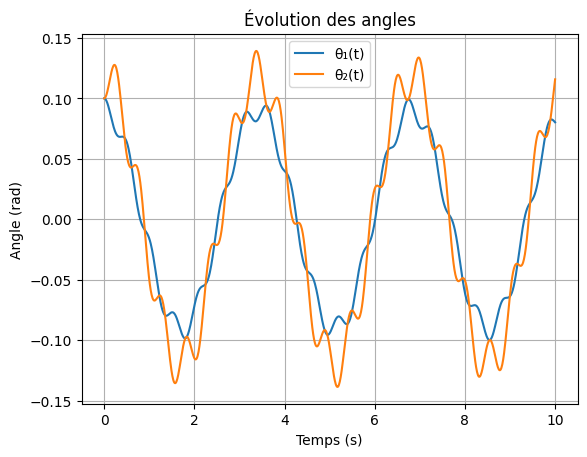

In [71]:
import matplotlib.pyplot as plt

plt.plot(sol.t, sol.y[0], label='θ₁(t)')
plt.plot(sol.t, sol.y[1], label='θ₂(t)')
#plt.plot(sol.t, sol.y[2], label='θ_3(t)')
plt.xlabel('Temps (s)')
plt.ylabel('Angle (rad)')
plt.title('Évolution des angles')
plt.legend()
plt.grid()
plt.show()
